In [72]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from IPython.display import HTML
import matplotlib as mpl

from collab2.foraging.toolkit import (
    animate_predictors,
    dataObject,
    derive_predictors_and_scores,
    plot_coefs,
    rescale_to_grid,
    subsample_frames_constant_frame_rate
)
from collab2.foraging.toolkit.velocity import _add_velocity

folder_path = "/Users/palka/Documents/Repositories/collab-creatures/data/foraging/two_fish"


## For all experiments, subsample and discretize and then plot distribution of step-sizes

- We want to choose discretization params such that frame-to-frame step sizes are small (order of 1 grid unit). To faithfully capture movement, we want to do this while keeping `frames_skipped` small. Which requires the `grid_size` we choose to be large enough. 

- Addition parameter `dt` that is used to calculate velocities after frames have been subsampled. Induces a smoothing.

- We expect distributions of $\theta$ (i.e. angle of velocity) to be uniform in [$-\pi$, $\pi$] as there is no innate preference for a swimming direction. But if `frames_skipped` is too small then $v_x=0, v_y=0$ which results in high probability mass at 0 (because of np.arctan2(0,0) = 0) or only one of v_x, v_y being non-zero which results in high probability mass at ($\pm\pi,\pm\pi/2,0$)

#### !! Can skip fewer frames for older fish as they are more motile
But that changes time units which would require more care while comparing across experiments. For now choose the same. 

original_frames: 36144
original_shape: (72288, 4)
resulting_frames: 3615
resulting_shape: (7230, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35500
original_shape: (71000, 4)
resulting_frames: 3550
resulting_shape: (7100, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35423
original_shape: (70846, 4)
resulting_frames: 3543
resulting_shape: (7086, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35734
original_shape: (71468, 4)
resulting_frames: 3574
resulting_shape: (7148, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35293
original_shape: (70586, 4)
resulting_frames: 3530
resulting_shape: (7060, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35677
original_shape: (71354, 4)
resulting_frames: 3568
resulting_shape: (7136, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35437
original_shape: (70874, 4)
resulting_frames: 3544
resulting_shape: (7088, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35634
original_shape: (71268, 4)
resulting_frames: 3564
resulting_shape: (7128, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35273
original_shape: (70546, 4)
resulting_frames: 3528
resulting_shape: (7056, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35253
original_shape: (70506, 4)
resulting_frames: 3526
resulting_shape: (7052, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35352
original_shape: (70704, 4)
resulting_frames: 3536
resulting_shape: (7072, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35379
original_shape: (70758, 4)
resulting_frames: 3538
resulting_shape: (7076, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 30536
original_shape: (61072, 4)
resulting_frames: 3054
resulting_shape: (6108, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35952
original_shape: (71904, 4)
resulting_frames: 3596
resulting_shape: (7192, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 34739
original_shape: (69478, 4)
resulting_frames: 3474
resulting_shape: (6948, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35924
original_shape: (71848, 4)
resulting_frames: 3593
resulting_shape: (7186, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 35259
original_shape: (70518, 4)
resulting_frames: 3526
resulting_shape: (7052, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


original_frames: 25428
original_shape: (50856, 4)
resulting_frames: 2543
resulting_shape: (5086, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(


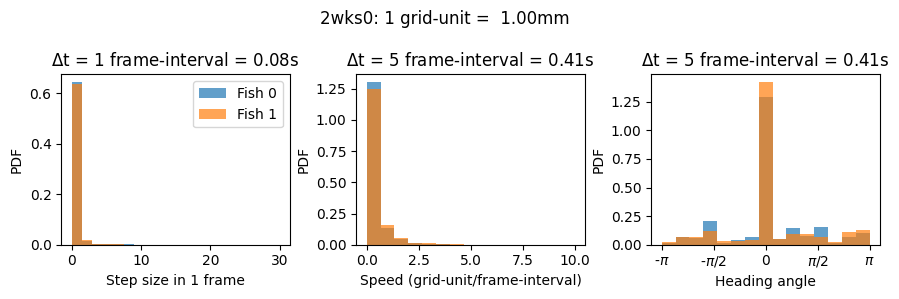

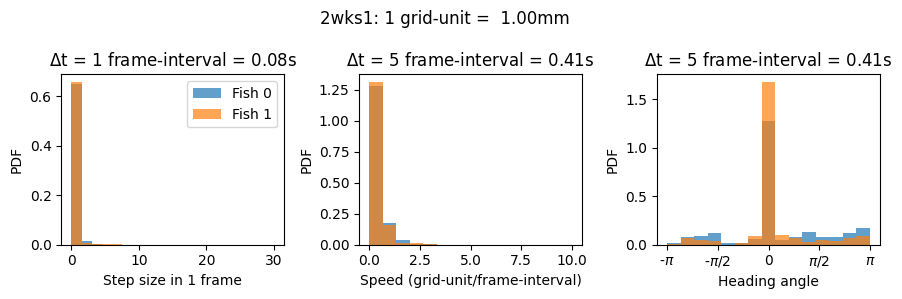

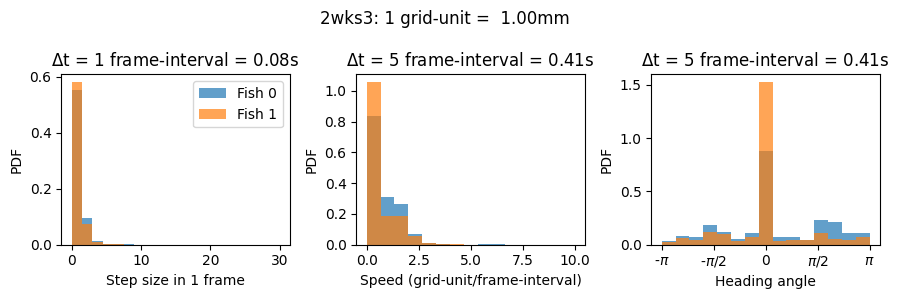

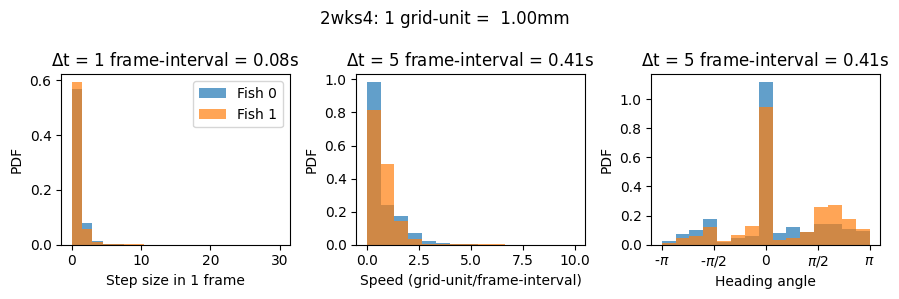

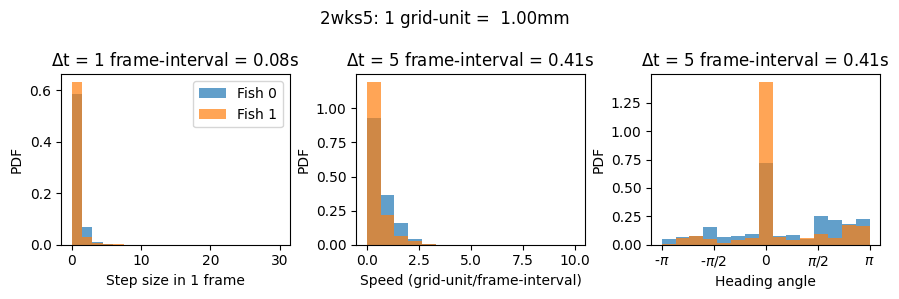

...

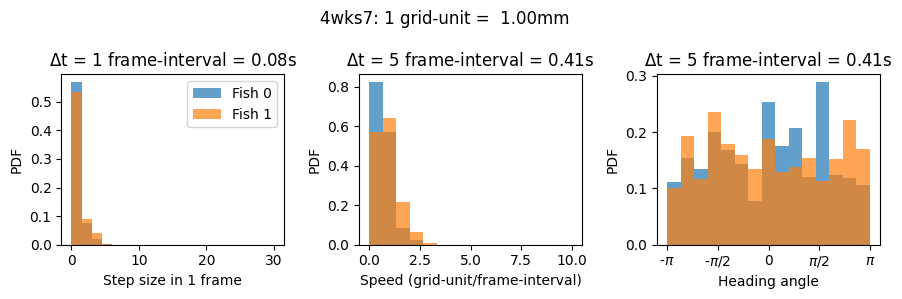

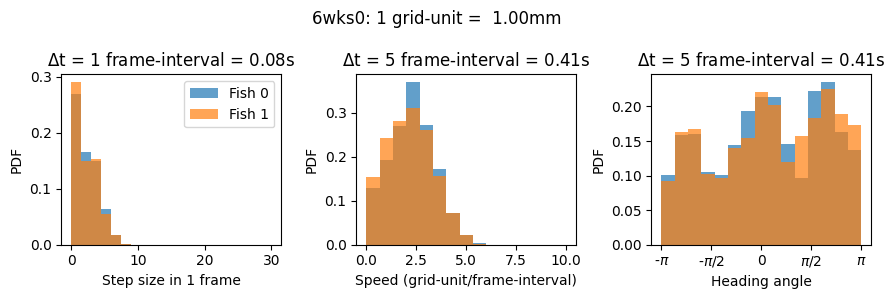

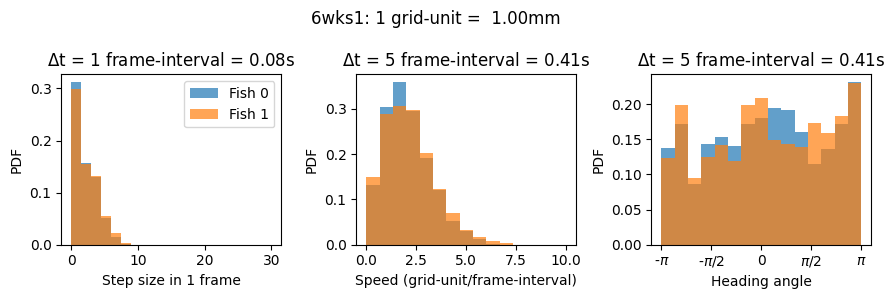

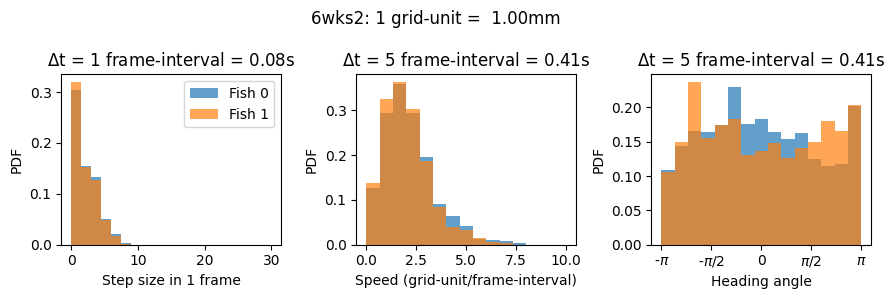

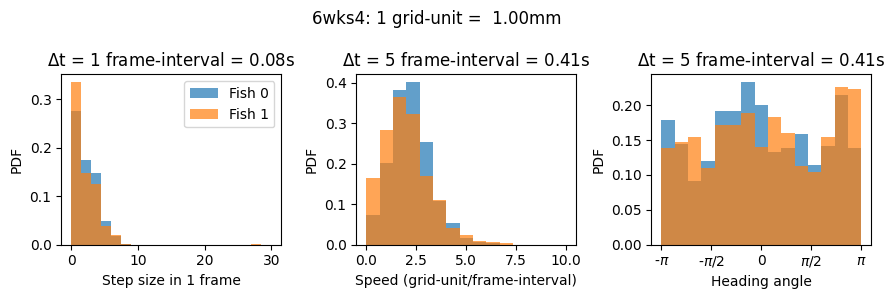

In [36]:
exp_details = pd.read_csv(f"{folder_path}/exp_details.csv")
fps = 121
frames_skipped = 10

# dt is used for calculating velocities after frames have been subsampled
# having dt > 1 induces some smoothing effectively

dt = 5

# actual interval used to calculate velocities
interval = frames_skipped*dt / fps

for i in range(len(exp_details)):
    arena_size = exp_details["px_to_mm"][i]*1000 #in mm
    grid_size = int(arena_size)
    exp = exp_details["experiment"][i]

    foragersDF = pd.read_csv(f"{folder_path}/{exp}.csv")

    # scaling and subsampling
    foragersDF_scaled = rescale_to_grid(
        foragersDF, size=grid_size, gridMin=0, gridMax=arena_size
    )
    foragersDF_scaled_subsampled = subsample_frames_constant_frame_rate(foragersDF_scaled,frame_spacing=frames_skipped)

    # create foragers object
    object_2wpf = dataObject(
        foragersDF_scaled_subsampled,
        grid_size=grid_size,
    )

    # calculate velocity using chosen dt 
    processed_list, _ = _add_velocity(object_2wpf.foragers, dt=dt)

    # calculate frame-to-frame step_sizes using dt=1
    step_size_list, _ = _add_velocity(object_2wpf.foragers, dt=1)

    bins_s = np.linspace(0,30,21)
    bins_v = np.linspace(0,10,16)
    bins_theta = np.linspace(-np.pi,np.pi,16)
    fig,ax = plt.subplots(1,3,figsize=(9,3))
    for i,df in enumerate(processed_list):
        ax[0].hist(step_size_list[i]["v_dt=1"].values,bins=bins_s,density=True, label=f"Fish {i}",alpha=0.7)
        ax[1].hist(df[f"v_dt={dt}"].values,bins=bins_v,density=True, label=f"Fish {i}",alpha=0.7)
        ax[2].hist(df[f"theta_dt={dt}"].values,bins=bins_theta,density=True, label=f"Fish {i}",alpha=0.7)

    ax[0].set_xlabel("Step size in 1 frame")
    ax[0].set_ylabel("PDF")
    ax[0].set_title(fr"$\Delta$t = 1 frame-interval = {frames_skipped/fps :.2f}s")
    ax[0].legend()
    ax[1].set_xlabel("Speed (grid-unit/frame-interval)")
    ax[1].set_ylabel("PDF")
    ax[1].set_title(fr"$\Delta$t = {dt} frame-interval = {dt*frames_skipped/fps :.2f}s")
    ax[2].set_xlabel("Heading angle")
    ax[2].set_ylabel("PDF")
    ax[2].set_xticks([-np.pi,-np.pi/2,0,np.pi/2,np.pi], ["-$\pi$", "-$\pi/2$", "0", "$\pi/2$", "$\pi$"])
    ax[2].set_title(fr"$\Delta$t = {dt} frame-interval = {dt*frames_skipped/fps :.2f}s")
    #ax[1].legend()

    fig.suptitle(fr"{exp}: 1 grid-unit = {arena_size/grid_size : .2f}mm")
    fig.tight_layout()



# Parameter choices


In [100]:
frames_skipped = 10 
dt = 5
window_size = 10 # grid-units, smaller than step-size
sigma_v = 5 # units: grid-unit/frame-interval
sigma_t = np.pi/8 
L_list = [10,40,70,100] #grid_units

# grid_size = arena_size for each experiment


score_kwargs = {
    "nextStepExponential" : {
        "decay_length" : 5
    }
}

predictor_kwargs = {
    "velocityDiffusion" : {
        "sigma_v" : sigma_v,
        "sigma_t" : sigma_t,
        "dt" : dt
    }
}

for L in L_list:
    predictor_kwargs[f"pairwiseCopying_{L}"] = {
        "sigma_v" : sigma_v,
        "sigma_t" : sigma_t,
        "dt" : dt,
        "interaction_length" : L
    }

display(predictor_kwargs)

# define circular grid constraint function
def circular_constraint_func(grid, c_x, c_y, R):
    ind = ((grid["x"] - c_x) ** 2 + (grid["y"] - c_y) ** 2) < R**2
    return grid.loc[ind]


{'velocityDiffusion': {'sigma_v': 5, 'sigma_t': 0.39269908169872414, 'dt': 5},
 'pairwiseCopying_10': {'sigma_v': 5,
  'sigma_t': 0.39269908169872414,
  'dt': 5,
  'interaction_length': 10},
 'pairwiseCopying_40': {'sigma_v': 5,
  'sigma_t': 0.39269908169872414,
  'dt': 5,
  'interaction_length': 40},
 'pairwiseCopying_70': {'sigma_v': 5,
  'sigma_t': 0.39269908169872414,
  'dt': 5,
  'interaction_length': 70},
 'pairwiseCopying_100': {'sigma_v': 5,
  'sigma_t': 0.39269908169872414,
  'dt': 5,
  'interaction_length': 100}}

## Visualize predictors for one experiment of each age 

### 2 weeks

In [101]:
exp = "2wks0"
arena_size = 150

foragersDF = pd.read_csv(f"{folder_path}/{exp}.csv")
grid_size = arena_size

# scaling and subsampling
foragersDF_scaled = rescale_to_grid(
    foragersDF, size=grid_size, gridMin=0, gridMax=arena_size
)
foragersDF_scaled_subsampled = subsample_frames_constant_frame_rate(foragersDF_scaled,frame_spacing=frames_skipped)

# create foragers object
object_2wpf = dataObject(
    foragersDF_scaled_subsampled,
    grid_size=grid_size,
)

grid_constraint_params = {
    "c_x": grid_size / 2,
    "c_y": grid_size / 2,
    "R": grid_size / 2,
}

local_windows_kwargs = {
    "window_size": window_size,
    "sampling_fraction": 1,
    "skip_incomplete_frames": True,
    "grid_constraint": circular_constraint_func,
    "grid_constraint_params": grid_constraint_params,
}

# calculate predictors
derivedDF = derive_predictors_and_scores(
    object_2wpf,
    local_windows_kwargs=local_windows_kwargs,
    predictor_kwargs=predictor_kwargs,
    score_kwargs=score_kwargs,
    dropna=True,
    add_scaled_values=False,
)


# Also print percentage of frames where both fish are present
local_windows = object_2wpf.local_windows[0]

total = len(local_windows)
present = 0

for window in local_windows:
    if window is not None:
        present +=1

print(f"Fraction of frames with both fish present : {present/total}")


original_frames: 36144
original_shape: (72288, 4)
resulting_frames: 3615
resulting_shape: (7230, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(
2024-10-11 18:46:33,254 - Local windows completed in 31.17 seconds.
2024-10-11 18:46:57,717 - velocityDiffusion completed in 24.46 seconds.
2024-10-11 18:47:26,405 - pairwiseCopying_10 completed in 28.69 seconds.
2024-10-11 18:48:06,253 - pairwiseCopying_40 completed in 39.85 seconds.
2024-10-11 18:48:49,040 - pairwiseCopying_70 completed in 42.79 seconds.
2024-10-11 18:49:34,251 - pairwiseCopying_100 completed in 45.21 seconds.
2024-10-11 18:49:44,484 - nextStepExponential completed in 10.23 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/der

Fraction of frames with both fish present : 0.6232365145228216


2024-10-11 18:49:49,795 - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


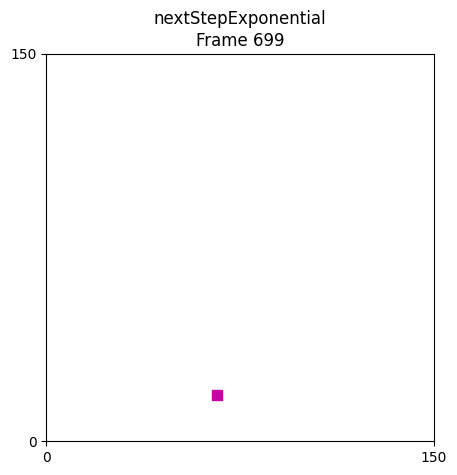

In [102]:
ani = animate_predictors(
    object_2wpf.foragersDF,
    object_2wpf.derived_quantities["nextStepExponential"],
    predictor_name="nextStepExponential",
    forager_position_indices=[0,1],
    forager_predictor_indices=[0,1],
    grid_size=grid_size,
    random_state=10,
    size_multiplier=3,
    fMin=400,
    fMax=700,
    frames_skipped=1,
)

HTML(ani.to_jshtml())

2024-10-11 18:59:47,602 - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


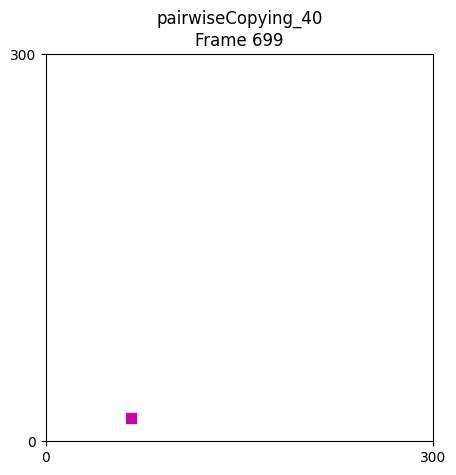

In [117]:
ani = animate_predictors(
    object_2wpf.foragersDF,
    object_2wpf.derived_quantities["pairwiseCopying_40"],
    predictor_name="pairwiseCopying_40",
    forager_position_indices=[0,1],
    forager_predictor_indices=[0,1],
    grid_size=grid_size,
    random_state=10,
    size_multiplier=1,
    fMin=400,
    fMax=700,
    frames_skipped=1,
)

HTML(ani.to_jshtml())

2024-10-11 18:50:57,607 - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


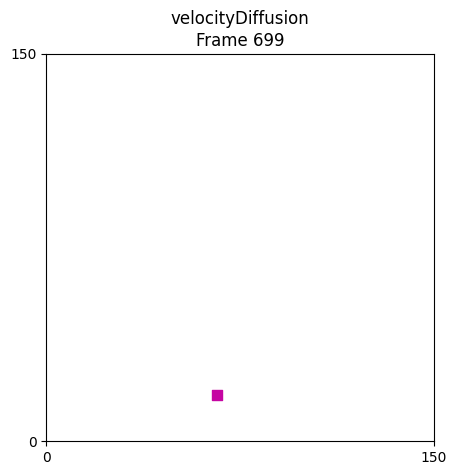

In [104]:
ani = animate_predictors(
    object_2wpf.foragersDF,
    object_2wpf.derived_quantities["velocityDiffusion"],
    predictor_name="velocityDiffusion",
    forager_position_indices=[0,1],
    forager_predictor_indices=[0,1],
    grid_size=grid_size,
    random_state=10,
    size_multiplier=1,
    fMin=400,
    fMax=700,
    frames_skipped=1,
)

HTML(ani.to_jshtml())

In [105]:
def plot_distributions(derivedDF, column_names):
    fig, ax = plt.subplots(1, len(column_names), figsize=(3 * len(column_names), 3))

    for i, column in enumerate(column_names):
        ax[i].hist(derivedDF[column], bins=20, density=True, alpha=1)
        ax[i].set_yscale("log")
        ax[i].set_ylim([10**-3, 10**2])
        ax[i].set_xlabel(column)
        ax[i].set_ylabel("PDF")

    fig.tight_layout()

def plot_density(derivedDF, predictors, scores, title):
    n_plots = len(predictors) * len(scores)
    #print(n_plots)
    ncols = 3
    nrows = np.ceil(n_plots / ncols).astype(int)
    fig, axes = plt.subplots(nrows, ncols, figsize=(4 * ncols, 3 * nrows))

    plot_index = 0
    for i, predictor_name in enumerate(predictors):
        for j, score_name in enumerate(scores):

            if nrows > 1:
                r = plot_index // ncols
                c = plot_index % ncols
                #print([r,c])
                ax = axes[r, c]
            else:
                ax = axes[plot_index]

            heatmap = ax.hexbin(
                derivedDF[predictor_name].values,
                derivedDF[score_name].values,
                gridsize=100,
                cmap="Blues",
                norm=mpl.colors.LogNorm(),
            )
            fig.colorbar(heatmap, ax=ax)
            ax.set_xlabel(f"{predictor_name} predictor")
            ax.set_ylabel(f"{score_name} score")
            # ax.set_aspect("equal")
            plot_index += 1

    # remove unused plots
    if n_plots % ncols:
        for ind in range(n_plots % ncols, ncols):
            if nrows > 1:
                fig.delaxes(axes[nrows-1,ind])
            else:
                fig.delaxes(axes[ind])

    fig.suptitle(title)
    fig.tight_layout()




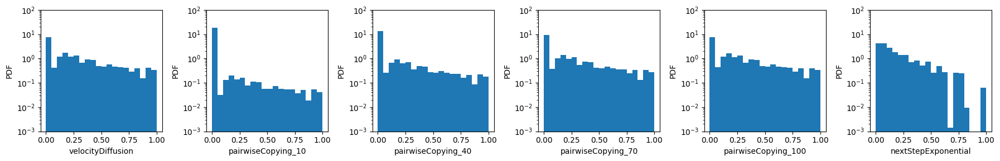

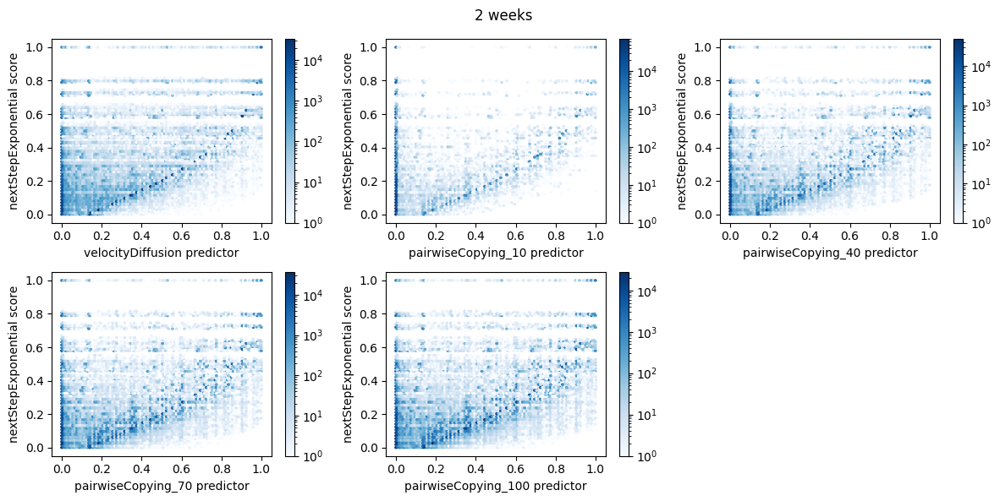

In [106]:
plot_distributions(object_2wpf.derivedDF, list(predictor_kwargs.keys())+list(score_kwargs.keys()))
plot_density(object_2wpf.derivedDF,predictors=predictor_kwargs.keys(),scores=score_kwargs.keys(),title="2 weeks")

### 4 weeks

In [107]:
exp = "4wks0"
arena_size = 300

foragersDF = pd.read_csv(f"{folder_path}/{exp}.csv")
grid_size = arena_size

# scaling and subsampling
foragersDF_scaled = rescale_to_grid(
    foragersDF, size=grid_size, gridMin=0, gridMax=arena_size
)
foragersDF_scaled_subsampled = subsample_frames_constant_frame_rate(foragersDF_scaled,frame_spacing=frames_skipped)

# create foragers object
object_4wpf = dataObject(
    foragersDF_scaled_subsampled,
    grid_size=grid_size,
)

grid_constraint_params = {
    "c_x": grid_size / 2,
    "c_y": grid_size / 2,
    "R": grid_size / 2,
}

local_windows_kwargs = {
    "window_size": window_size,
    "sampling_fraction": 1,
    "skip_incomplete_frames": True,
    "grid_constraint": circular_constraint_func,
    "grid_constraint_params": grid_constraint_params,
}

# calculate predictors
derivedDF = derive_predictors_and_scores(
    object_4wpf,
    local_windows_kwargs=local_windows_kwargs,
    predictor_kwargs=predictor_kwargs,
    score_kwargs=score_kwargs,
    dropna=True,
    add_scaled_values=False,
)


# Also print percentage of frames where both fish are present
local_windows = object_4wpf.local_windows[0]

total = len(local_windows)
present = 0

for window in local_windows:
    if window is not None:
        present +=1

print(f"Fraction of frames with both fish present : {present/total}")


original_frames: 35634
original_shape: (71268, 4)
resulting_frames: 3564
resulting_shape: (7128, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(
2024-10-11 18:51:57,457 - Local windows completed in 15.44 seconds.
2024-10-11 18:52:08,623 - velocityDiffusion completed in 11.17 seconds.
2024-10-11 18:52:19,720 - pairwiseCopying_10 completed in 11.10 seconds.
2024-10-11 18:52:42,152 - pairwiseCopying_40 completed in 22.43 seconds.
2024-10-11 18:53:02,291 - pairwiseCopying_70 completed in 20.14 seconds.
2024-10-11 18:53:22,258 - pairwiseCopying_100 completed in 19.97 seconds.
2024-10-11 18:53:25,819 - nextStepExponential completed in 3.56 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/deri

Fraction of frames with both fish present : 0.239337822671156


2024-10-11 18:53:27,394 - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


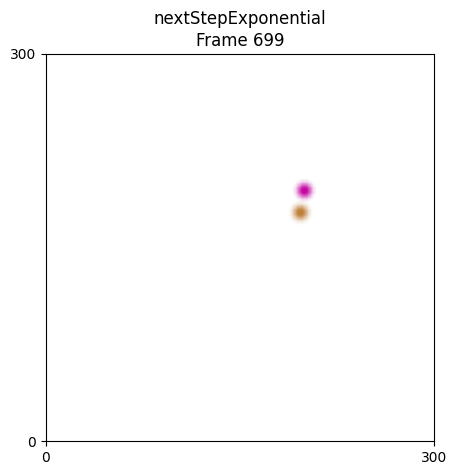

In [108]:
ani = animate_predictors(
    object_4wpf.foragersDF,
    object_4wpf.derived_quantities["nextStepExponential"],
    predictor_name="nextStepExponential",
    forager_position_indices=[],
    forager_predictor_indices=[0,1],
    grid_size=grid_size,
    random_state=10,
    size_multiplier=1,
    fMin=400,
    fMax=700,
    frames_skipped=1,
)

HTML(ani.to_jshtml())

2024-10-11 18:53:57,842 - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


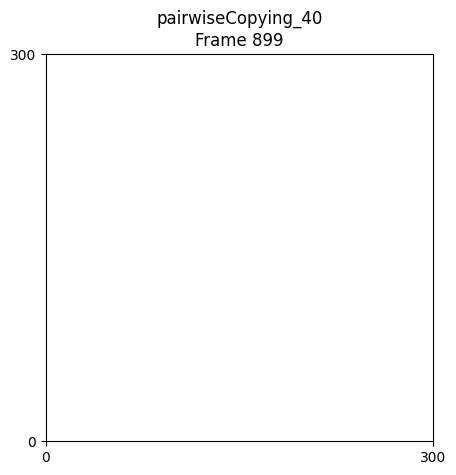

In [109]:
ani = animate_predictors(
    object_4wpf.foragersDF,
    object_4wpf.derived_quantities["pairwiseCopying_40"],
    predictor_name="pairwiseCopying_40",
    forager_position_indices=[],
    forager_predictor_indices=[0,1],
    grid_size=grid_size,
    random_state=10,
    size_multiplier=1,
    fMin=700,
    fMax=900,
    frames_skipped=1,
)

HTML(ani.to_jshtml())

2024-10-11 18:54:18,026 - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


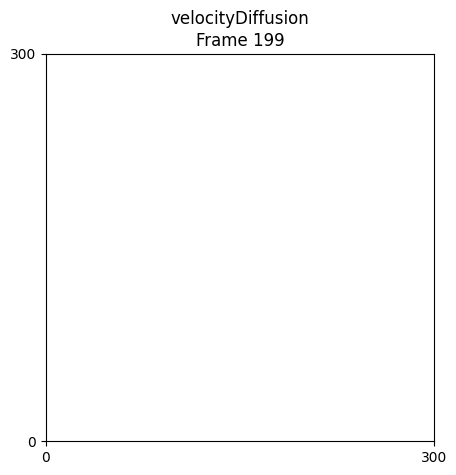

In [110]:
ani = animate_predictors(
    object_4wpf.foragersDF,
    object_4wpf.derived_quantities["velocityDiffusion"],
    predictor_name="velocityDiffusion",
    forager_position_indices=[],
    forager_predictor_indices=[0,1],
    grid_size=grid_size,
    random_state=10,
    size_multiplier=1,
    fMin=0,
    fMax=200,
    frames_skipped=1,
)

HTML(ani.to_jshtml())

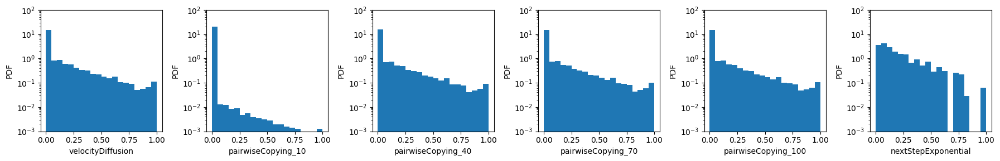

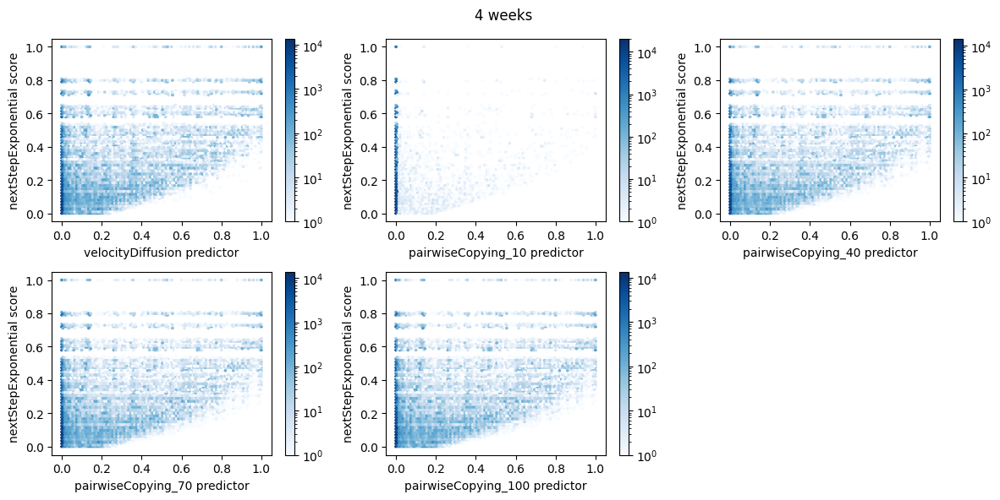

In [111]:
plot_distributions(object_4wpf.derivedDF, list(predictor_kwargs.keys())+list(score_kwargs.keys()))
plot_density(object_4wpf.derivedDF,predictors=predictor_kwargs.keys(),scores=score_kwargs.keys(),title="4 weeks")

### 6 weeks

In [112]:
exp = "6wks0"
arena_size = 300

foragersDF = pd.read_csv(f"{folder_path}/{exp}.csv")
grid_size = arena_size

# scaling and subsampling
foragersDF_scaled = rescale_to_grid(
    foragersDF, size=grid_size, gridMin=0, gridMax=arena_size
)
foragersDF_scaled_subsampled = subsample_frames_constant_frame_rate(foragersDF_scaled,frame_spacing=frames_skipped)

# create foragers object
object_6wpf = dataObject(
    foragersDF_scaled_subsampled,
    grid_size=grid_size,
)

grid_constraint_params = {
    "c_x": grid_size / 2,
    "c_y": grid_size / 2,
    "R": grid_size / 2,
}

local_windows_kwargs = {
    "window_size": window_size,
    "sampling_fraction": 1,
    "skip_incomplete_frames": True,
    "grid_constraint": circular_constraint_func,
    "grid_constraint_params": grid_constraint_params,
}

# calculate predictors
derivedDF = derive_predictors_and_scores(
    object_6wpf,
    local_windows_kwargs=local_windows_kwargs,
    predictor_kwargs=predictor_kwargs,
    score_kwargs=score_kwargs,
    dropna=True,
    add_scaled_values=False,
)


# Also print percentage of frames where both fish are present
local_windows = object_6wpf.local_windows[0]

total = len(local_windows)
present = 0

for window in local_windows:
    if window is not None:
        present +=1

print(f"Fraction of frames with both fish present : {present/total}")


original_frames: 34739
original_shape: (69478, 4)
resulting_frames: 3474
resulting_shape: (6948, 4)


/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/utils.py:42: UserWarning: 
                NaN values in data. The default behavior of predictor/score generating functions is
                to ignore foragers with missing positional data. To modify, see documentation of
                `derive_predictors_and_scores` and `generate_local_windows`
                
  warnings.warn(
2024-10-11 18:55:14,408 - Local windows completed in 25.39 seconds.
2024-10-11 18:55:36,871 - velocityDiffusion completed in 22.46 seconds.
2024-10-11 18:55:57,891 - pairwiseCopying_10 completed in 21.02 seconds.
2024-10-11 18:56:41,001 - pairwiseCopying_40 completed in 43.11 seconds.
2024-10-11 18:57:24,333 - pairwiseCopying_70 completed in 43.33 seconds.
2024-10-11 18:58:02,192 - pairwiseCopying_100 completed in 37.86 seconds.
2024-10-11 18:58:08,204 - nextStepExponential completed in 6.01 seconds.
/Users/palka/Documents/Repositories/collab-creatures/collab2/foraging/toolkit/deri

Fraction of frames with both fish present : 0.44041450777202074


2024-10-11 18:58:12,151 - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


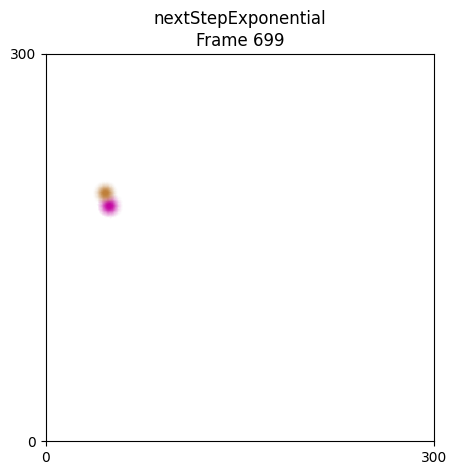

In [113]:
ani = animate_predictors(
    object_6wpf.foragersDF,
    object_6wpf.derived_quantities["nextStepExponential"],
    predictor_name="nextStepExponential",
    forager_position_indices=[],
    forager_predictor_indices=[0,1],
    grid_size=grid_size,
    random_state=10,
    size_multiplier=1,
    fMin=400,
    fMax=700,
    frames_skipped=1,
)

HTML(ani.to_jshtml())

2024-10-11 18:58:45,369 - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


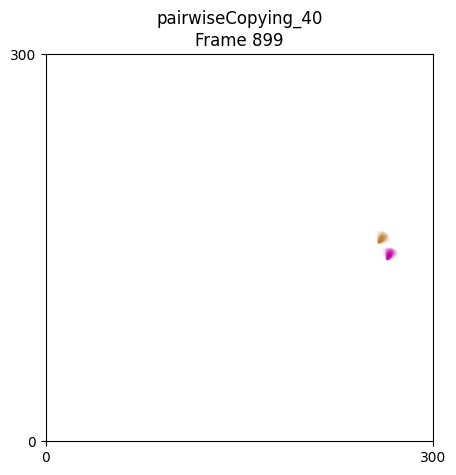

In [114]:
ani = animate_predictors(
    object_6wpf.foragersDF,
    object_6wpf.derived_quantities["pairwiseCopying_40"],
    predictor_name="pairwiseCopying_40",
    forager_position_indices=[],
    forager_predictor_indices=[0,1],
    grid_size=grid_size,
    random_state=10,
    size_multiplier=1,
    fMin=700,
    fMax=900,
    frames_skipped=1,
)

HTML(ani.to_jshtml())

2024-10-11 18:59:14,718 - Animation.save using <class 'matplotlib.animation.HTMLWriter'>


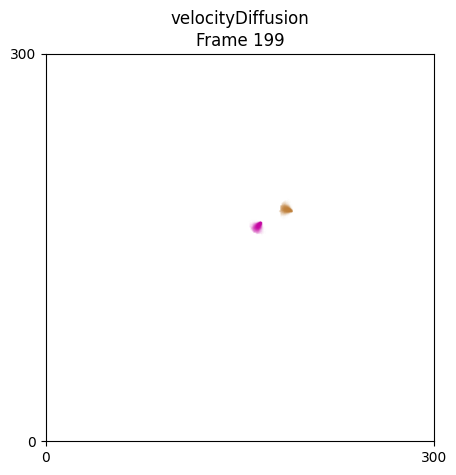

In [115]:
ani = animate_predictors(
    object_6wpf.foragersDF,
    object_6wpf.derived_quantities["velocityDiffusion"],
    predictor_name="velocityDiffusion",
    forager_position_indices=[],
    forager_predictor_indices=[0,1],
    grid_size=grid_size,
    random_state=10,
    size_multiplier=1,
    fMin=0,
    fMax=200,
    frames_skipped=1,
)

HTML(ani.to_jshtml())

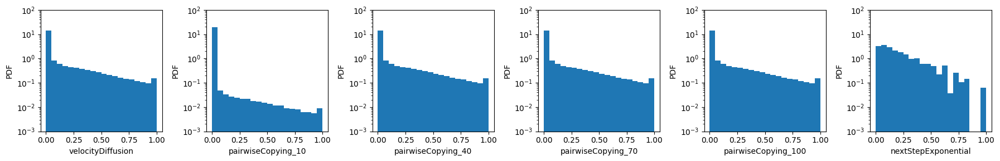

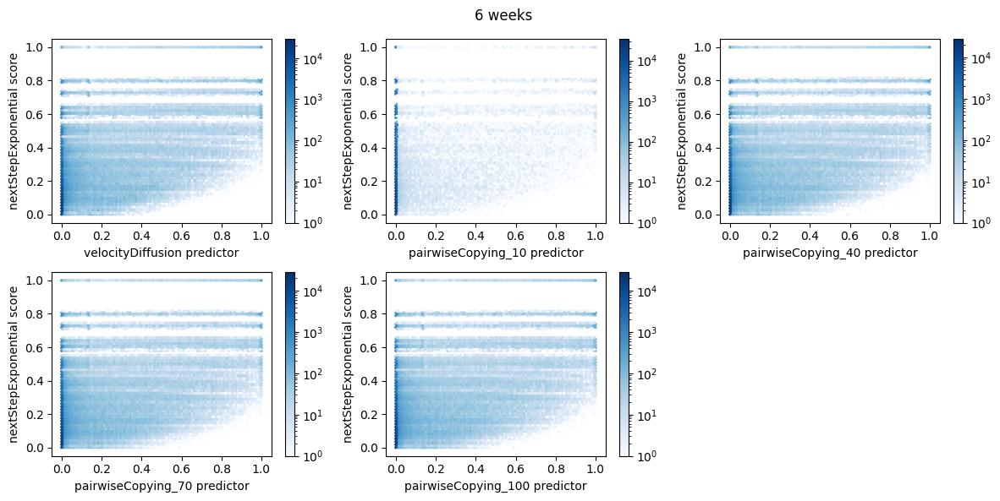

In [116]:
plot_distributions(object_6wpf.derivedDF, list(predictor_kwargs.keys())+list(score_kwargs.keys()))
plot_density(object_6wpf.derivedDF,predictors=predictor_kwargs.keys(),scores=score_kwargs.keys(),title="6 weeks")